In [13]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import tensorflow as tf
import os as os
from tqdm import tqdm

In [2]:
# Define the input and output directories
input_dir = "ImageDATASET"
output_dir = "Resized"

In [3]:
# Create the output directory if it doesn't exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

In [4]:
# Get the list of image filenames in the input directory
image_filenames = os.listdir(input_dir)

# Iterate over each image and resize it
for filename in tqdm(image_filenames, desc="Resizing Images"):
    # Read the image
    img_path = os.path.join(input_dir, filename)
    img = cv.imread(img_path)

    # Resize the image to 600x400
    resized_img = cv.resize(img, (600, 400))

    # Save the resized image to the output directory
    output_path = os.path.join(output_dir, filename)
    cv.imwrite(output_path, resized_img)

print("Resizing and saving complete.")

Resizing Images: 100%|█████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 20.80it/s]

Resizing and saving complete.


## CLAHE Process

In [25]:
# Create the output directory if it doesn't exist
output_dir = "CLAHEed"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

In [26]:
# Function to apply CLAHE to an image
def apply_clahe(img):
    hsv_img = cv.cvtColor(img, cv.COLOR_RGB2HSV)
    h, s, v = hsv_img[:, :, 0], hsv_img[:, :, 1], hsv_img[:, :, 2]
    clahe = cv.createCLAHE(clipLimit=15.0, tileGridSize=(8, 8))
    v = clahe.apply(v)
    hsv_img = np.dstack((h, s, v))
    return cv.cvtColor(hsv_img, cv.COLOR_HSV2RGB)

In [27]:
# Read all images from the Resized folder, apply CLAHE, and save to the CLAHEed folder
resized_dir = "Resized"
images = os.listdir(resized_dir)

Processing: 100%|██████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 41.27it/s]


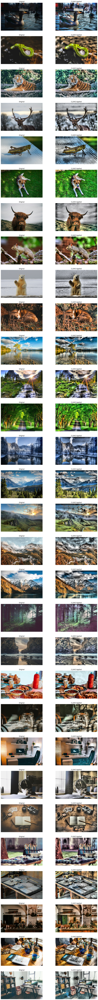

In [53]:
fig, axes = plt.subplots(len(images), 2, figsize=(15, 150))

for idx, image_name in enumerate(tqdm(images, desc="Processing")):
    # Read the image
    img_path = os.path.join(resized_dir, image_name)
    img = cv.imread(img_path)
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    
    # Apply CLAHE
    clahe_img = apply_clahe(img)
    
    # Save the CLAHE-processed image to the output directory
    output_path = os.path.join(output_dir, image_name)
    cv.imwrite(output_path, cv.cvtColor(clahe_img, cv.COLOR_RGB2BGR))
    
    # Plot the original and CLAHE-processed images
    axes[idx, 0].imshow(img)
    axes[idx, 0].set_title("Original")
    axes[idx, 0].axis("off")
    
    axes[idx, 1].imshow(clahe_img)
    axes[idx, 1].set_title("CLAHE Applied")
    axes[idx, 1].axis("off")

plt.show()